In [264]:
import random
import numpy as np
import pandas as pd 
import scipy.spatial
from haversine import haversine
import shapefile

In [45]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

In [189]:
import json

In [5]:
msa_df = pd.read_csv('Data/Asurion MA expansion_MSA_City_Zip_Info_20210401.csv')

In [16]:
wama_data = msa_df[msa_df.MSA_Name == 'Washington-Baltimore, DC-MD-VA-WV CMSA'][['ZipCode','Population','Latitude','Longitude']]

In [34]:
data['Population'] = data.Population.astype(int)

In [42]:
data = data[data.Latitude != 0]

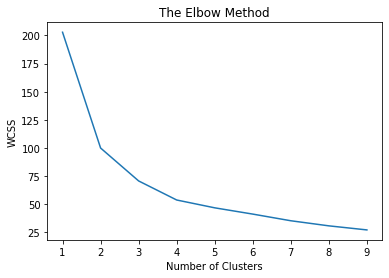

In [81]:
wcss=[]
s_score = []
for i in range(1,10):
    kmeans=KMeans(n_clusters=i, init='k-means++',random_state=0).fit(data[['Latitude','Longitude']].values, sample_weight = data.Population.values)
#     kmeans.fit(data[['Latitude','Longitude']].values, sample_weight = data.Population.values)
    wcss.append(kmeans.inertia_)
    if i == 1:
        s_score.append(i)
    else:
        s_score.append(silhouette_score(data[['Latitude','Longitude']].values, kmeans.fit_predict(data[['Latitude','Longitude']])))
#     print(kmeans.cluster_centers_)
plt.plot(range(1,10),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

In [84]:
s_score

[1,
 0.47766584702901677,
 0.5177475361262198,
 0.5300807186456512,
 0.5342710423583418,
 0.5300250489194491,
 0.515303366149153,
 0.49834294884240765,
 0.5071225916514549]

In [ ]:
# Based on silhoutte score k = 5. Since business wants 1-3 clusters in each MSA assigning k = 3  

In [98]:
kmeans=KMeans(n_clusters=3, init='k-means++',random_state=0).fit(data[['Latitude','Longitude']].values, sample_weight = data.Population.values)

In [99]:
assiged_clusters = kmeans.fit_predict(data[['Latitude','Longitude']].values, sample_weight = data.Population.values)

In [100]:
data['asigned_clusters'] =assiged_clusters

C:\Users\ruta.deshmukh.NEW_STERLING\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [103]:
data

,ZipCode,Population,Latitude,Longitude,asigned_clusters
2821,20001,38551,38.910717,-77.016660,0
2822,20002,52370,38.908089,-76.976663,0
2823,20003,26454,38.877752,-76.986546,0
2824,20004,1622,38.892444,-77.020588,0
2825,20005,12775,38.904224,-77.031798,0
...,...,...,...,...,...
6614,56920,0,38.900000,-77.040000,0
6615,56933,0,38.860000,-76.990000,0
6617,56944,0,38.860000,-76.990000,0
6618,56945,0,38.895092,-77.036555,0


In [104]:
# Plotting clusters on map

In [111]:
import shapefile
import os

In [138]:
import folium

In [116]:
# assert os.path.exists(shp_path), "Input file does not exist."

In [178]:
sf = shapefile.Reader("C:/Users/ruta.deshmukh.NEW_STERLING/Desktop/All projects/MA_coverage/zip_level_shape_files/MSA_shapefiles/cb_2018_us_cbsa_500k.shp")
geoj  = sf.__geo_interface__

In [182]:
# initialize the map and store it in a m object
m = folium.Map(location=[40, -95], zoom_start=6)

In [183]:
folium.GeoJson(geoj, name="geojson").add_to(m)

In [184]:
m

In [ ]:
# Reading zip code shapefiles

In [186]:
# zip_level_shape_files has 36083 zip codes
sf_zip = shapefile.Reader("C:/Users/ruta.deshmukh.NEW_STERLING/Desktop/All projects/MA_coverage/zip_level_shape_files/cb_2018_us_zcta510_500k.shp")
geoj_zip  = sf_zip.__geo_interface__

In [197]:
geoj_zip

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'ZCTA5CE10': '36083',
    'AFFGEOID10': '8600000US36083',
    'GEOID10': '36083',
    'ALAND10': 659750662,
    'AWATER10': 5522919},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[(-85.63224699999999, 32.280982),
       (-85.624387, 32.281632),
       (-85.62433999999999, 32.28165),
       (-85.624185, 32.28138),
       (-85.620121, 32.277853),
       (-85.614705, 32.274806999999996),
       (-85.608606, 32.272207),
       (-85.602234, 32.270424999999996),
       (-85.598241, 32.270412),
       (-85.589951, 32.271755),
       (-85.581518, 32.270027),
       (-85.584075, 32.268763),
       (-85.586249, 32.265912),
       (-85.590397, 32.262374),
       (-85.591123, 32.258823),
       (-85.591441, 32.252680999999995),
       (-85.594015, 32.252696),
       (-85.597792, 32.255324),
       (-85.60002999999999, 32.254925),
       (-85.600794, 32.256231),
       (-85.60604, 32.2579),
       (-85

In [233]:
cluster_list = data[data.asigned_clusters == 0]['ZipCode'].to_list()

In [263]:
feature_list = []
for each in geoj_zip['features']:
#     zip_list.append(each['properties']['ZCTA5CE10'])
    for each['properties']['ZCTA5CE10'] in cluster_list:
        feature_list.append(each)
#     count = count+1

KeyboardInterrupt: 

In [ ]:
feature_list

In [ ]:
geoj_clust0 = geoj_zip

In [ ]:
geoj_clust0['features'] = []

In [ ]:
geoj_clust0

In [242]:
zip_list_df = pd.DataFrame(zip_list)

In [244]:
import dtale

In [237]:
cluster_list

[20001,
 20002,
 20003,
 20004,
 20005,
 20006,
 20007,
 20008,
 20009,
 20010,
 20011,
 20012,
 20013,
 20015,
 20016,
 20017,
 20018,
 20019,
 20020,
 20022,
 20024,
 20026,
 20027,
 20029,
 20030,
 20032,
 20033,
 20035,
 20036,
 20037,
 20038,
 20039,
 20040,
 20042,
 20043,
 20044,
 20045,
 20047,
 20049,
 20050,
 20052,
 20053,
 20055,
 20056,
 20057,
 20058,
 20059,
 20060,
 20061,
 20062,
 20063,
 20064,
 20065,
 20066,
 20067,
 20068,
 20069,
 20070,
 20071,
 20073,
 20074,
 20075,
 20076,
 20077,
 20078,
 20080,
 20081,
 20082,
 20090,
 20091,
 20189,
 20201,
 20202,
 20203,
 20204,
 20206,
 20207,
 20208,
 20210,
 20211,
 20212,
 20213,
 20214,
 20215,
 20216,
 20217,
 20218,
 20219,
 20220,
 20221,
 20222,
 20223,
 20224,
 20226,
 20227,
 20228,
 20229,
 20230,
 20232,
 20233,
 20235,
 20237,
 20238,
 20239,
 20240,
 20241,
 20242,
 20244,
 20245,
 20250,
 20251,
 20252,
 20254,
 20260,
 20261,
 20262,
 20265,
 20266,
 20268,
 20270,
 20277,
 20289,
 20299,
 20301,
 20303,


In [245]:
dtale.show(zip_list_df)

2021-04-06 15:09:12,965 - INFO     - NumExpr defaulting to 8 threads.


In [229]:
count

33144

In [ ]:
#Filtering on ZCTA510 that represents zip code

In [215]:
# [x for x in geoj_zip if x['ZCTA5CE10'] == 20001]
[x for x in geoj_zip['features'] if x['properties']['ZCTA5CE10'] in(data[data.asigned_clusters == 0]['ZipCode']) ]

[]

In [216]:
data

,ZipCode,Population,Latitude,Longitude,asigned_clusters
2821,20001,38551,38.910717,-77.016660,0
2822,20002,52370,38.908089,-76.976663,0
2823,20003,26454,38.877752,-76.986546,0
2824,20004,1622,38.892444,-77.020588,0
2825,20005,12775,38.904224,-77.031798,0
...,...,...,...,...,...
6614,56920,0,38.900000,-77.040000,0
6615,56933,0,38.860000,-76.990000,0
6617,56944,0,38.860000,-76.990000,0
6618,56945,0,38.895092,-77.036555,0


In [203]:
data[data.asigned_clusters == 0]['ZipCode']

2821    20001
2822    20002
2823    20003
2824    20004
2825    20005
        ...  
6614    56920
6615    56933
6617    56944
6618    56945
6627    56972
Name: ZipCode, Length: 574, dtype: int64